In [3]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

import warnings
warnings.filterwarnings('ignore')


/var/folders/3d/y6gkr5jx61gb3p0k4jbmxc6c0000gn/T/ipykernel_52427/1356604295.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [4]:
df = pd.read_csv("data.csv")
df.head()


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [5]:
df.reset_index(drop= False, inplace= True)

In [6]:
df=df.drop(columns=['id' , 'Unnamed: 32'], axis=1)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   index                    569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [8]:
df.describe()

,index,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,284.000000,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,164.400426,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,142.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,284.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,426.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,568.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [9]:
label_encoder= LabelEncoder()

df["diagnosis"] = label_encoder.fit_transform(df["diagnosis"])


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   index                    569 non-null    int64  
 1   diagnosis                569 non-null    int64  
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

## Visualization


In [11]:
sns.set_theme(style="ticks")

sns.pairplot(df, hue="diagnosis")

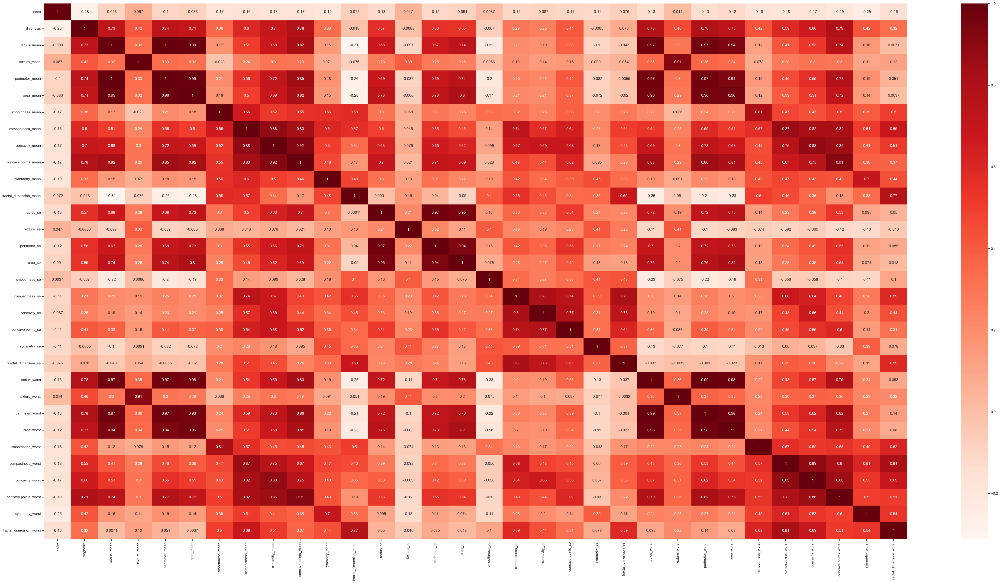

In [12]:
plt.figure(figsize=(60,30))
cor = df.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

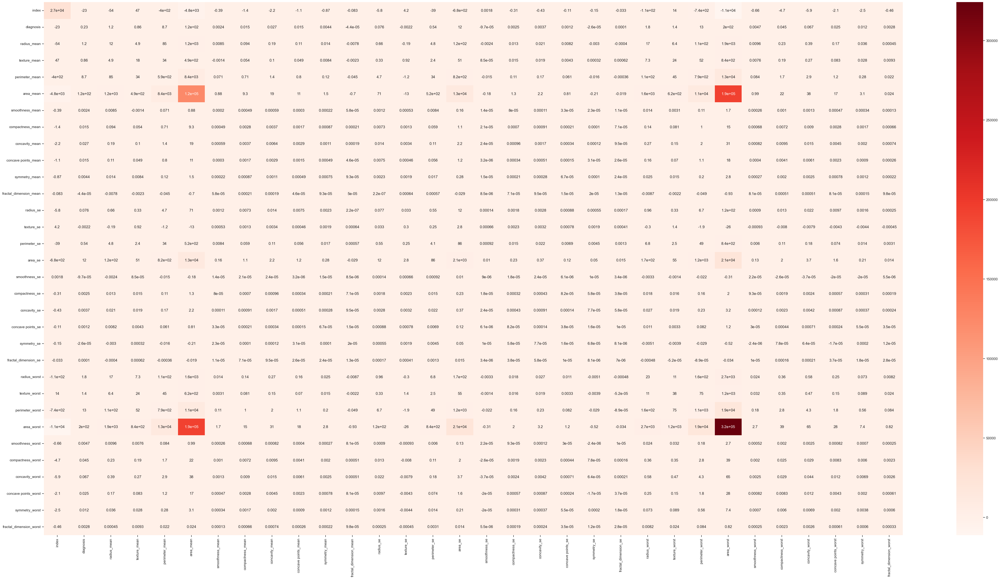

In [13]:
plt.figure(figsize=(60,30))
cor = df.cov()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

In [15]:
diagnosis = df['diagnosis'].value_counts()

fig = px.pie(values = diagnosis,
             names=diagnosis.index,
            template= 'plotly_dark',
             title= 'Distribution of the type of the diagnosis in the dataset'
            )
fig.show()

<Axes: >

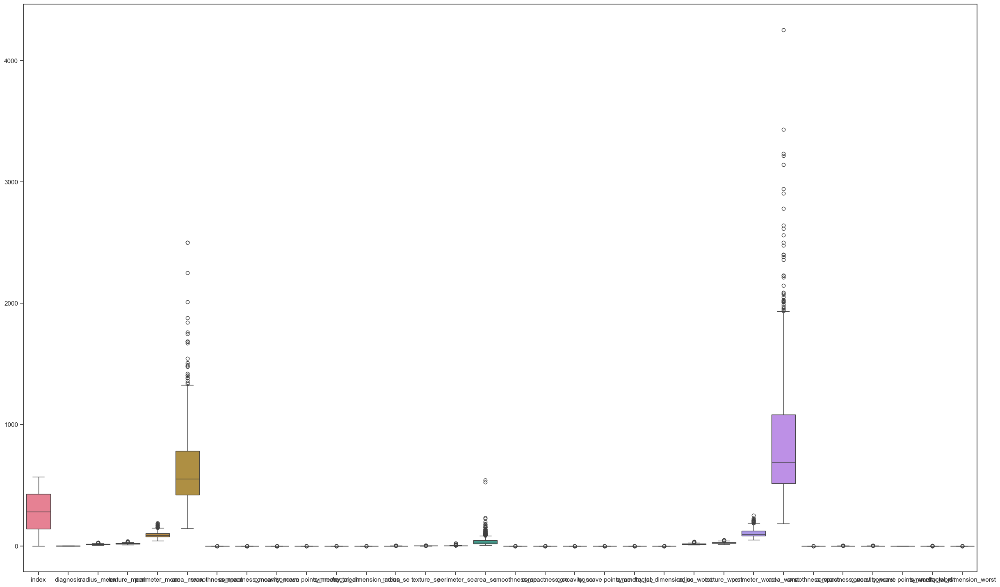

In [17]:
plt.figure(figsize=(30,18))
sns.boxplot(data=df)

## Custom ANN Model

In [18]:
X_train1, X_test1, y_train, y_test= train_test_split(df.drop('diagnosis', axis=1), df.diagnosis, test_size= 0.3, random_state=42)

In [19]:
from sklearn.preprocessing import StandardScaler, RobustScaler

scaler = RobustScaler()
X_train = scaler.fit_transform(X_train1)
X_test = scaler.transform(X_test1)

In [20]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Concatenate

# Assuming you have X_train, y_train, X_test, y_test
unique_labels = len(np.unique(y_train))

from keras.utils import to_categorical

# Assuming y_train1 is your original target variable
# Convert it to one-hot encoded format
y_train1_encoded = to_categorical(y_train, num_classes=unique_labels)

# Similarly, do the same for your test set if needed
y_test_encoded = to_categorical(y_test, num_classes=unique_labels)


# Define the first sub-model
def sub_model1(inputs):
    x = Dense(128, activation='relu')(inputs)
    x = Dense(512, activation='relu')(x)
    x = Dense(64, activation='relu')(x)
    return x

# Define the second sub-model
def sub_model2(inputs):
    x = Dense(256, activation='relu')(inputs)
    x = Dense(1024, activation='relu')(x)
    x = Dense(2048, activation='relu')(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(128, activation='relu')(x)
    return x

# Define the first sub-model
def sub_model3(inputs):
    x = Dense(64, activation='relu')(inputs)
    x = Dense(512, activation='relu')(x)
    x = Dense(128, activation='relu')(x)

    return x

# Define the second sub-model
def sub_model4(inputs):
    x = Dense(256, activation='relu')(inputs)
    x = Dense(1024, activation='relu')(x)
    x = Dense(2048, activation='relu')(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(128, activation='relu')(x)
    x = Dense(64, activation='relu')(x)
    return x
# Input layer
input_layer = Input(shape=(X_train.shape[1],))

# Create the first sub-model
sub_model1_output = sub_model1(input_layer)

# Create the second sub-model
sub_model2_output = sub_model2(input_layer)

# Concatenate the outputs of the two sub-models
concatenated_output = Concatenate()([sub_model1_output, sub_model2_output])

# Add additional layers for the combined model
input_layer_1= Dense(32, activation='relu')(concatenated_output)

sub_model3_output = sub_model3(input_layer_1)

# Create the second sub-model
sub_model4_output = sub_model4(input_layer_1)

# Concatenate the outputs of the two sub-models
concatenated_output_1 = Concatenate()([sub_model3_output, sub_model4_output])

x = Dense(32, activation='relu')(concatenated_output_1)
output_layer = Dense(unique_labels, activation='softmax')(x)

# Create the final model
model = Model(inputs=input_layer, outputs=output_layer)

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
# model.fit(X_train2, y_train1, epochs=10, batch_size=32, validation_data=(X_test, y_test))
history = model.fit(X_train, y_train1_encoded, epochs=10, validation_data=(X_test, y_test_encoded))

Epoch 1/10
13/13 [==============================] - 1s 35ms/step - loss: 0.3898 - accuracy: 0.8492 - val_loss: 0.1030 - val_accuracy: 0.9532
Epoch 2/10
13/13 [==============================] - 0s 22ms/step - loss: 0.1633 - accuracy: 0.9623 - val_loss: 0.0634 - val_accuracy: 0.9649
Epoch 3/10
13/13 [==============================] - 0s 23ms/step - loss: 0.0813 - accuracy: 0.9749 - val_loss: 0.1215 - val_accuracy: 0.9532
Epoch 4/10
13/13 [==============================] - 0s 22ms/step - loss: 0.0621 - accuracy: 0.9749 - val_loss: 0.0766 - val_accuracy: 0.9766
Epoch 5/10
13/13 [==============================] - 0s 21ms/step - loss: 0.0255 - accuracy: 0.9925 - val_loss: 0.1443 - val_accuracy: 0.9591
Epoch 6/10
13/13 [==============================] - 0s 20ms/step - loss: 0.0152 - accuracy: 0.9925 - val_loss: 0.1109 - val_accuracy: 0.9649
Epoch 7/10
13/13 [==============================] - 0s 21ms/step - loss: 0.0053 - accuracy: 1.0000 - val_loss: 0.1318 - val_accuracy: 0.9708
Epoch 8/10
13

In [23]:
history = pd.DataFrame(history.history)

AttributeError: 'DataFrame' object has no attribute 'history'